In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
pip install keras-preprocessing

In [3]:
import re
import pickle

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf

import plotly.graph_objs as go
import plotly.colors as colors

In [4]:
from wordcloud import WordCloud

from tensorflow import keras
from keras.models import Sequential
from tensorflow.keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences

from keras import layers
from keras.models import Model
from keras.layers import SimpleRNN, LSTM, Bidirectional, GRU
from keras.layers import Input, MultiHeadAttention, Attention, AdditiveAttention

from keras.layers import Embedding, Dense, Dropout, BatchNormalization
from keras.optimizers import Adam

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

# **TASK 1,2,3: Data exploration, preprocessing and EDA**

In [5]:
fields = ['text', 'sentiment']
df = pd.read_csv(
    '/content/test.csv', # change this to train.csv for more data
    encoding='ISO-8859-1',
    on_bad_lines='skip',
    usecols=fields
)
df.head(5)

,text,sentiment
0,Last session of the day http://twitpic.com/67ezh,neutral
1,Shanghai is also really exciting (precisely -...,positive
2,"Recession hit Veronique Branquinho, she has to...",negative
3,happy bday!,positive
4,http://twitpic.com/4w75p - I like it!!,positive


In [6]:
df.shape

(4815, 2)

In [7]:
df.isnull().sum()

text         1281
sentiment    1281
dtype: int64

In [8]:
# df['sentiment']=df['sentiment'].fillna("neutral")

In [9]:
df.dropna(inplace=True)

In [10]:
df['sentiment'].isnull().sum()

0

In [11]:
df['sentiment'].value_counts()

sentiment
neutral     1430
positive    1103
negative    1001
Name: count, dtype: int64

In [12]:
import nltk

nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [13]:
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize


In [14]:
# def clean(text):
#     text = re.sub(r'[^a-zA-Z\s]', '', str(text))
#     # Conver to lower
#     text = text.lower()
#     # Remove extra whitespaces
#     text = re.sub(r'\s+', ' ', text).strip()
#     return text
#
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english'))

def clean(text):
    text = re.sub(r'[^a-zA-Z\s]', '', str(text))
    # Convert text to lowercase
    text = text.lower()
    # Remove special characters and digits
    text = re.sub(r'\W', ' ', text)
    text = re.sub(r'\d', ' ', text)
    text = re.sub(r'\s+', ' ', text).strip()
    # Tokenize the text
#     words = word_tokenize(text)
#     # Remove stopwords and lemmatize the words
#     words = [lemmatizer.lemmatize(word) for word in words if word not in stop_words]
#     return ' '.join(words)
    return text

In [15]:
df['text'] = df['text'].apply(clean)


In [16]:
df['text'].head(2)

0            last session of the day httptwitpiccomezh
1    shanghai is also really exciting precisely sky...
Name: text, dtype: object

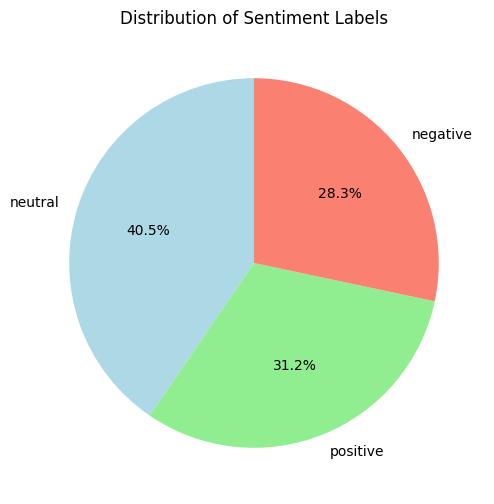

In [17]:
import matplotlib.pyplot as plt

# Analyze the distribution of sentiment labels in the train dataset
sentiment_counts = df['sentiment'].value_counts()

# Plot the distribution as a pie chart
plt.figure(figsize=(8, 6))
sentiment_counts.plot.pie(autopct='%1.1f%%', startangle=90, colors=['lightblue', 'lightgreen', 'salmon'])
plt.title('Distribution of Sentiment Labels')
plt.ylabel('')
plt.show()


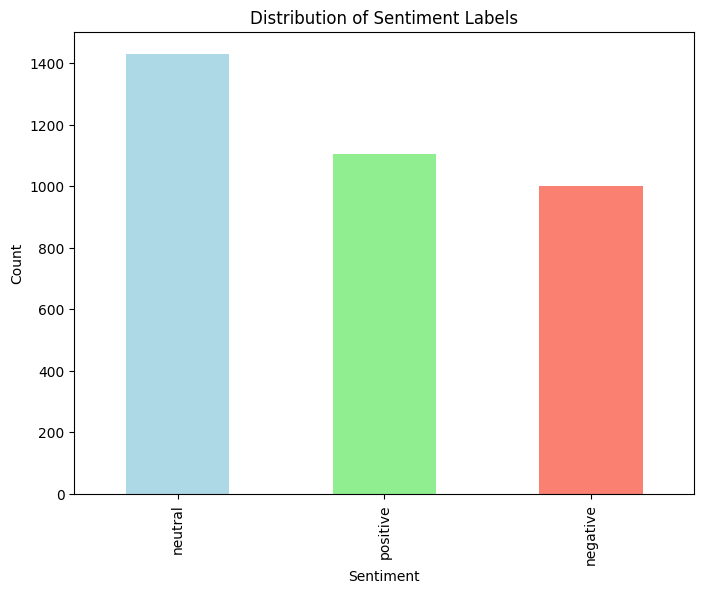

In [18]:
# Plot the distribution as a histogram
plt.figure(figsize=(8, 6))
sentiment_counts.plot.bar(color=['lightblue', 'lightgreen', 'salmon'])
plt.title('Distribution of Sentiment Labels')
plt.xlabel('Sentiment')
plt.ylabel('Count')
plt.show()

In [19]:
word_lengths = [len(word) for text in df['text'] for word in text.split()]
word_lengths_counts = {length: word_lengths.count(length) for length in set(word_lengths)}

# Sort the word lengths by count in descending order
sorted_word_lengths = sorted(word_lengths_counts.items(), key=lambda x: x[1], reverse=True)


In [20]:
colorscale = colors.sample_colorscale('Magma', len(word_lengths_counts))
palette = ["#F000FF", "#F00F00", "#0F00FF"]
# Create the bar chart trace
bar_trace = go.Bar(
    x=[length for length, count in sorted_word_lengths],
    y=[count for length, count in sorted_word_lengths],
    marker=dict(
        color=[colorscale[i] for i in range(len(sorted_word_lengths))],
        line=dict(
            color=palette[0],
            width=2
        )
    ),
    hovertemplate='Word Length: %{x}<br>Count: %{y}<extra></extra>'
)

In [21]:
fig = go.Figure(data=[bar_trace])
fig.show()

In [22]:
fig.update_layout(
    title="Word Lengths Counts",
    xaxis_title="Word Length",
    yaxis_title="Count",
)

In [23]:
#WORD CLOUD
# Word Cloud for Positive Sentiment
positive_text = ' '.join(df[df['sentiment'] == 'positive']['text'])
wordcloud = WordCloud(background_color='black', width = 800, height = 400, max_words=200, colormap='Greens').generate(positive_text)
fig = go.Figure(go.Image(z = np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title = 'Word Cloud For Positive Sentiment',
    plot_bgcolor = 'blue',
    paper_bgcolor = 'yellow',
    font_color = palette[2],
    title_font_color = palette[2],
    title_font_size = 20,
    margin = dict(t = 80, l = 50, r = 50, b = 50)
)
fig.show()

In [24]:
negative_text = ' '.join(df[df['sentiment'] == 'negative']['text'])
wordcloud = WordCloud(background_color='black', width=800, height=400, max_words=200, colormap='Reds').generate(negative_text)
fig = go.Figure(go.Image(z=np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title="Word Cloud for Negative Sentiment",
    plot_bgcolor="black",
    paper_bgcolor="red",
    font_color=palette[1],
    title_font_color=palette[2],
    title_font_size=20,
    margin=dict(t=80, l=50, r=50, b=50)
)
fig.show()

In [25]:
# Word Cloud for Neutral Sentiment
neutral_text = ' '.join(df[df['sentiment'] == 'neutral']['text'])
wordcloud = WordCloud(background_color='black', width=800, height=400, max_words=200, colormap='Blues').generate(neutral_text)
fig = go.Figure(go.Image(z=np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title="Word Cloud for Neutral Sentiment",
    plot_bgcolor="black",
    paper_bgcolor="black",
    font_color=palette[2],
    title_font_color=palette[2],
    title_font_size=20
)
fig.show()

In [26]:
# Tokenize Text
tokenizer = Tokenizer()
tokenizer.fit_on_texts(df['text'])
sequences = tokenizer.texts_to_sequences(df['text'])

In [27]:
# sequences

In [28]:
# Determine the maximum sequence length
max_seq_length = max(len(seq) for seq in sequences)

# Pad the sequences to ensure uniform length
padded_seqs = pad_sequences(sequences, maxlen=max_seq_length, padding='post')

# Convert sentiment labels to one-hot encoding
one_hot_labels = pd.get_dummies(df['sentiment']).values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(padded_seqs, one_hot_labels, test_size=0.4)

# Print the training data
print(X_train)
print(Y_train)



[[  28  114 2043 ...    0    0    0]
 [   1 5521  117 ...    0    0    0]
 [4547  232  114 ...    0    0    0]
 ...
 [ 129  213    9 ...    0    0    0]
 [ 602 4742  310 ...    0    0    0]
 [  10  698  198 ...    0    0    0]]
[[False False  True]
 [False False  True]
 [False  True False]
 ...
 [False  True False]
 [False False  True]
 [False False  True]]


# **TASK 4 & TASK 5: Text Vectorization, Model Selection**

# TFIDF

In [29]:
#TFIDF for svm

In [30]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split

# Example text data
corpus = df['text'].tolist()  # Assuming the text data is in a column named 'text'

# Initialize the TF-IDF vectorizer
tfidf_vectorizer = TfidfVectorizer(max_features=5000)  # You can adjust max_features

# Fit and transform the text data to TF-IDF vectors
tfidf_vectors = tfidf_vectorizer.fit_transform(corpus)

# Convert sentiment labels to one-hot encoding
one_hot_labels = pd.get_dummies(df['sentiment']).values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(tfidf_vectors, one_hot_labels, test_size=0.4)

# Print the shape of the training data
print(X_train.shape)
print(Y_train.shape)


(2120, 5000)
(2120, 3)


In [31]:
tfidf_vectors

<3534x5000 sparse matrix of type '<class 'numpy.float64'>'
	with 36928 stored elements in Compressed Sparse Row format>

In [32]:
#USE TFIDF FOR NAIVE BAYES AND SVM

In [33]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score, classification_report


#train the Naive Bayes model
nb_model = MultinomialNB()
nb_model.fit(X_train, Y_train.argmax(axis=1))

# Make predictions
Y_pred = nb_model.predict(X_test)

# Evaluate the model
print(f"Accuracy: {accuracy_score(Y_test.argmax(axis=1), Y_pred)}")
print(classification_report(Y_test.argmax(axis=1), Y_pred))


Accuracy: 0.5678925035360679
              precision    recall  f1-score   support

           0       0.77      0.22      0.35       404
           1       0.49      0.87      0.62       574
           2       0.79      0.49      0.60       436

    accuracy                           0.57      1414
   macro avg       0.68      0.53      0.52      1414
weighted avg       0.66      0.57      0.54      1414



In [34]:
from sklearn.svm import SVC

# Initialize and train the SVM model
svm_model = SVC(kernel='linear')
svm_model.fit(X_train, Y_train.argmax(axis=1))

# Make predictions
Y_pred = svm_model.predict(X_test)

# Evaluate the model
print(f"Accuracy: {accuracy_score(Y_test.argmax(axis=1), Y_pred)}")
print(classification_report(Y_test.argmax(axis=1), Y_pred))


Accuracy: 0.6152758132956153
              precision    recall  f1-score   support

           0       0.63      0.44      0.52       404
           1       0.55      0.76      0.63       574
           2       0.77      0.59      0.67       436

    accuracy                           0.62      1414
   macro avg       0.65      0.60      0.61      1414
weighted avg       0.64      0.62      0.61      1414



# WORD EMBEDDINGS

In [35]:
from keras.models import Sequential
from keras.layers import Embedding, LSTM, Dense, SpatialDropout1D
from keras.preprocessing.sequence import pad_sequences
from keras.preprocessing.text import Tokenizer
from sklearn.model_selection import train_test_split
import pandas as pd

texts = df['text'].tolist()

# Tokenize the text data
tokenizer = Tokenizer(num_words=5000)
tokenizer.fit_on_texts(texts)
sequences = tokenizer.texts_to_sequences(texts)
word_index = tokenizer.word_index

# Pad the sequences
max_seq_length = max(len(seq) for seq in sequences)
data = pad_sequences(sequences, maxlen=max_seq_length)

# Convert sentiment labels to one-hot encoding
one_hot_labels = pd.get_dummies(df['sentiment']).values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(data, one_hot_labels, test_size=0.4, random_state=42)

# Initialize the LSTM model
lstm_model = Sequential()
lstm_model.add(Embedding(input_dim=len(word_index) + 1, output_dim=100, input_length=max_seq_length))
lstm_model.add(SpatialDropout1D(0.2))
lstm_model.add(LSTM(100, dropout=0.2, recurrent_dropout=0.2))
lstm_model.add(Dense(one_hot_labels.shape[1], activation='softmax'))

# Compile the model
lstm_model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
lstm_model.fit(X_train, Y_train, epochs=5, batch_size=64, validation_data=(X_test, Y_test), verbose=2)

# Evaluate the model
loss, accuracy = lstm_model.evaluate(X_test, Y_test, verbose=0)
print(f"Accuracy: {accuracy}")


Epoch 1/5
34/34 - 23s - loss: 1.0848 - accuracy: 0.3976 - val_loss: 1.0743 - val_accuracy: 0.4059 - 23s/epoch - 684ms/step
Epoch 2/5
34/34 - 8s - loss: 1.0301 - accuracy: 0.4712 - val_loss: 1.0108 - val_accuracy: 0.5297 - 8s/epoch - 246ms/step
Epoch 3/5
34/34 - 7s - loss: 0.8207 - accuracy: 0.6769 - val_loss: 0.8595 - val_accuracy: 0.6047 - 7s/epoch - 201ms/step
Epoch 4/5
34/34 - 8s - loss: 0.5357 - accuracy: 0.7986 - val_loss: 0.8668 - val_accuracy: 0.6223 - 8s/epoch - 244ms/step
Epoch 5/5
34/34 - 9s - loss: 0.3564 - accuracy: 0.8722 - val_loss: 1.0391 - val_accuracy: 0.6103 - 9s/epoch - 253ms/step
Accuracy: 0.6103253364562988


In [36]:
#Best Model is SVC

# **TASK 6: HYPERPARAMETER TUNING**

In [37]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.datasets import load_digits
X=X_train
y=Y_train.argmax(axis=1)

# Define parameter grid for Grid Search
param_grid = {
    'C': [0.1, 1, 10],
    # 'kernel': ['linear', 'rbf'],
    'gamma': ['scale', 'auto']
}
grid_search = GridSearchCV(SVC(), param_grid, cv=5, scoring='accuracy', verbose=1)

# Perform Grid Search
grid_search.fit(X_train, Y_train.argmax(axis=1))

# Print the best parameters and best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best accuracy: {grid_search.best_score_}")

# Evaluate the best model on the test set
best_svm_model = grid_search.best_estimator_
Y_pred_best_svm = best_svm_model.predict(X_test)
best_svm_accuracy = accuracy_score(Y_test.argmax(axis=1), Y_pred_best_svm)
print(f"Best SVM Test Accuracy: {best_svm_accuracy}")

Fitting 5 folds for each of 6 candidates, totalling 30 fits
Best parameters: {'C': 1, 'gamma': 'auto'}
Best accuracy: 0.40896226415094344
Best SVM Test Accuracy: 0.40947666195190946


# **TASK 7: CROSS VALIDATION**


In [38]:
from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC
from sklearn.datasets import load_digits
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

In [39]:
pipeline = make_pipeline(StandardScaler(), svm_model)

# Perform cross-validation on the entire dataset using the best model
cross_val_scores = cross_val_score(pipeline, X, y, cv=5, scoring='accuracy')

# Print cross-validation scores
print(f"Cross-validation scores: {cross_val_scores}")
print(f"Mean cross-validation accuracy: {cross_val_scores.mean()}")
print(f"Standard deviation of cross-validation accuracy: {cross_val_scores.std()}")

Cross-validation scores: [0.39622642 0.39858491 0.4009434  0.39858491 0.39386792]
Mean cross-validation accuracy: 0.39764150943396226
Standard deviation of cross-validation accuracy: 0.0024051978837701855


In [40]:


# Best parameters from RandomizedSearchCV
best_params= {'C': 1, 'gamma': 'auto'}

# Initialize SVM with best parameters
best_svm_model = SVC(**best_params)

# Create a pipeline (optional but recommended)
pipeline = make_pipeline(StandardScaler(), best_svm_model)

# Perform cross-validation on the entire dataset using the best model
cross_val_scores = cross_val_score(pipeline,X,y, cv=5, scoring='accuracy')

# Print cross-validation scores
print(f"Cross-validation scores: {cross_val_scores}")
print(f"Mean cross-validation accuracy: {cross_val_scores.mean()}")
print(f"Standard deviation of cross-validation accuracy: {cross_val_scores.std()}")


Cross-validation scores: [0.38207547 0.40330189 0.38679245 0.40330189 0.40801887]
Mean cross-validation accuracy: 0.39669811320754716
Standard deviation of cross-validation accuracy: 0.010269594838243966


# **TASK 8: MODEL INTERPRETEBILITY**

In [41]:
pip install lime


In [42]:
Y_train

array([[False,  True, False],
       [ True, False, False],
       [False, False,  True],
       ...,
       [False, False,  True],
       [False, False,  True],
       [False,  True, False]])

In [45]:
corpus = df['text'].tolist()  # Assuming the text data is in a column named 'text'

# Initialize the TF-IDF vectorizer
tfidf_vectorizer = TfidfVectorizer(max_features=5000)  # You can adjust max_features

# Fit and transform the text data to TF-IDF vectors
tfidf_vectors = tfidf_vectorizer.fit_transform(corpus)

# Convert sentiment labels to one-hot encoding
one_hot_labels = pd.get_dummies(df['sentiment']).values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(tfidf_vectors, one_hot_labels, test_size=0.4)

# Print the shape of the training data
print(X_train.shape)
print(Y_train.shape)

(2120, 5000)
(2120, 3)


In [46]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.feature_extraction.text import TfidfVectorizer
from lime import lime_text
from lime.lime_text import LimeTextExplainer

best_svm_model = SVC(**best_params, probability=True)  # probability=True is needed for LIME
best_svm_model.fit(X_train, Y_train.argmax(axis=1))

# Initialize LIME Text Explainer
explainer = LimeTextExplainer(class_names=['negative', 'neutral', 'positive'])

# Function to predict probabilities for LIME
def predict_proba(texts):
    transformed_texts = tfidf_vectorizer.transform(texts)
    return best_svm_model.predict_proba(transformed_texts)

# Choose an instance to explain (example: first instance from test set)
index_to_explain = 0
text_instance = df['text'].iloc[index_to_explain]
print(f"Text to explain: {text_instance}")

# Explain the prediction of the best SVM model using LIME
exp = explainer.explain_instance(text_instance, predict_proba, num_features=10)

# Display the explanation
exp.show_in_notebook(text=True)

# Print the explanation as a list
print(exp.as_list())


Text to explain: last session of the day httptwitpiccomezh


[('day', -0.40827053304739636), ('last', 0.11402038452890252), ('session', 0.08314001529451184), ('the', 0.03996830533160639), ('httptwitpiccomezh', -0.009765376449053287), ('of', 0.0057317862463107435)]


In [47]:
index_to_explain = 1
text_instance = df['text'].iloc[index_to_explain]
print(f"Text to explain: {text_instance}")

# Explain the prediction of the best SVM model using LIME
exp = explainer.explain_instance(text_instance, predict_proba, num_features=10)

# Display the explanation
exp.show_in_notebook(text=True)

# Print the explanation as a list
print(exp.as_list())

Text to explain: shanghai is also really exciting precisely skyscrapers galore good tweeps in china sh bj


[('good', -0.2509199478298812), ('tweeps', -0.036087864754488476), ('also', 0.03513305187596134), ('is', 0.017980253117378314), ('really', -0.012577625436332252), ('in', 0.008697647064083672), ('precisely', 0.002829752602358664), ('sh', 0.0025599558535797286), ('skyscrapers', 0.0025004796417396613), ('exciting', 0.0018117286691255554)]


In [48]:
index_to_explain = 15
text_instance = df['text'].iloc[index_to_explain]
print(f"Text to explain: {text_instance}")

# Explain the prediction of the best SVM model using LIME
exp = explainer.explain_instance(text_instance, predict_proba, num_features=10)

# Display the explanation
exp.show_in_notebook(text=True)

# Print the explanation as a list
print(exp.as_list())

Text to explain: so hot today dont like it and i hate my new timetable having such a bad week


[('my', -0.03232766271364342), ('hate', -0.03152943613749766), ('so', -0.02773842071655863), ('hot', -0.023778816238724878), ('dont', 0.0216995604324635), ('having', -0.02132021987624574), ('it', -0.020120883597767484), ('week', -0.0161698672941156), ('timetable', 0.01590279505297115), ('bad', 0.008341898000568952)]


# **TASK 9: EVALUATION METRICS**

In [49]:
y_pred = best_svm_model.predict(X_test)
y_pred_proba = best_svm_model.predict_proba(X_test)

In [50]:
Y_test_single_label = Y_test.argmax(axis=1)

# Compute confusion matrix
conf_matrix = confusion_matrix(Y_test_single_label, y_pred)

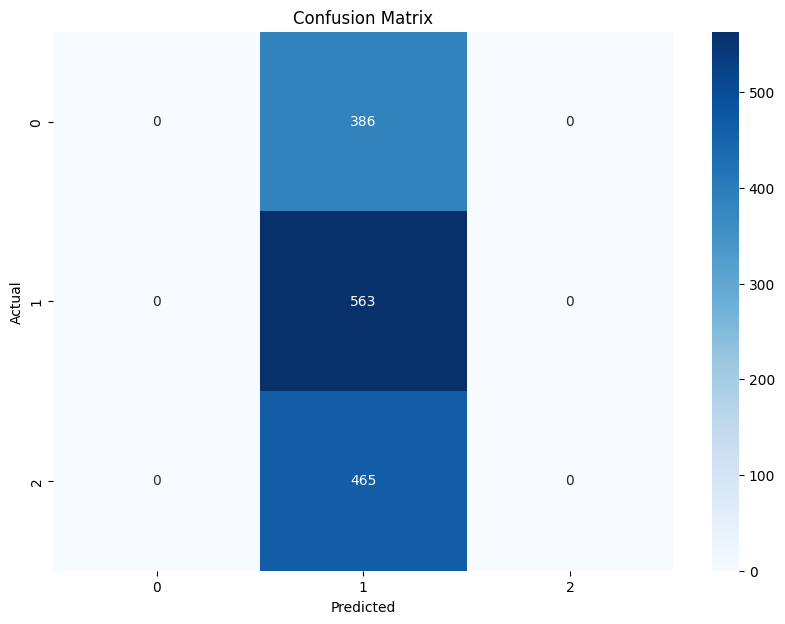

In [51]:
# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=best_svm_model.classes_, yticklabels=best_svm_model.classes_)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


In [52]:
# Classification report
print("Classification Report:")
print(classification_report(Y_test_single_label, y_pred))

Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       386
           1       0.40      1.00      0.57       563
           2       0.00      0.00      0.00       465

    accuracy                           0.40      1414
   macro avg       0.13      0.33      0.19      1414
weighted avg       0.16      0.40      0.23      1414



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [53]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, roc_curve, auc, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import seaborn as sns


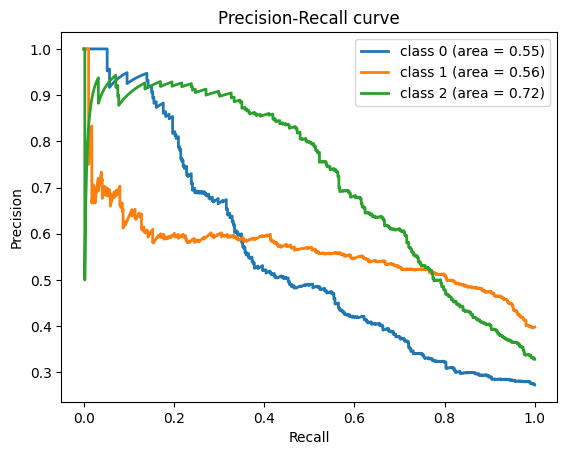

In [54]:
# Precision-Recall Curve
precision = dict()
recall = dict()
average_precision = dict()
n_classes = len(np.unique(Y_test_single_label))

for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(Y_test_single_label == i, y_pred_proba[:, i])
    average_precision[i] = average_precision_score(Y_test_single_label== i, y_pred_proba[:, i])

# Plot Precision-Recall curve
plt.figure()
for i in range(n_classes):
    plt.plot(recall[i], precision[i], lw=2, label='class {0} (area = {1:0.2f})'.format(i, average_precision[i]))

plt.xlabel("Recall")
plt.ylabel("Precision")
plt.legend(loc="best")
plt.title("Precision-Recall curve")
plt.show()

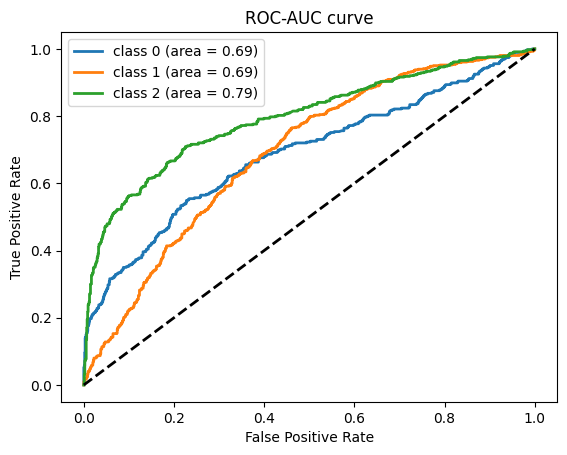

In [55]:
# ROC-AUC Curve
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(Y_test_single_label == i, y_pred_proba[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve
plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label='class {0} (area = {1:0.2f})'.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="best")
plt.title("ROC-AUC curve")
plt.show()


In [56]:
overall_roc_auc = roc_auc_score(Y_test_single_label, y_pred_proba, multi_class='ovr')
print(f"Overall ROC-AUC: {overall_roc_auc:.2f}")


Overall ROC-AUC: 0.72


In [57]:
import pickle
with open('best_svm_model.pkl', 'wb') as model_file:
    pickle.dump(best_svm_model, model_file)

with open('tfidf_vectorizer.pkl', 'wb') as vectorizer_file:
    pickle.dump(tfidf_vectorizer, vectorizer_file)